<p style="align: center;"><img align=center src="https://drive.google.com/uc?export=view&id=1TRNaCfYstvcIQqoUSdukYQGF6LuyL7Tv" width=600 height=320/></p>
<h3 style="text-align: center;"><b>Школа глубокого обучения ФПМИ МФТИ</b></h3>

# Домашнее задание. Автоэнкодеры


# Часть 1. Vanilla Autoencoder (10 баллов)

## 1.1. Подготовка данных (0.5 балла)


In [1]:
import os
from collections import defaultdict
import pickle

import numpy as np
import pandas as pd
import skimage.io
from skimage.transform import resize
from torch.autograd import Variable
from torchvision import datasets
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torch.utils.data as data_utils
import torch
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA

#%matplotlib inline

In [2]:
def fetch_dataset(attrs_name = "lfw_attributes.txt",
                  images_name = "lfw-deepfunneled",
                  dx=80,dy=80,
                  dimx=64,dimy=64
    ):

    #download if not exists
    if not os.path.exists(images_name):
        print("images not found, donwloading...")
        os.system("wget http://vis-www.cs.umass.edu/lfw/lfw-deepfunneled.tgz -O tmp.tgz")
        print("extracting...")
        os.system("tar xvzf tmp.tgz && rm tmp.tgz")
        print("done")
        assert os.path.exists(images_name)

    if not os.path.exists(attrs_name):
        print("attributes not found, downloading...")
        os.system("wget http://www.cs.columbia.edu/CAVE/databases/pubfig/download/%s" % attrs_name)
        print("done")

    #read attrs
    df_attrs = pd.read_csv("lfw_attributes.txt",sep='\t',skiprows=1,) 
    df_attrs = pd.DataFrame(df_attrs.iloc[:,:-1].values, columns = df_attrs.columns[1:])


    #read photos
    photo_ids = []
    for dirpath, dirnames, filenames in os.walk(images_name):
        for fname in filenames:
            if fname.endswith(".jpg"):
                fpath = os.path.join(dirpath,fname)
                photo_id = fname[:-4].replace('_',' ').split()
                person_id = ' '.join(photo_id[:-1])
                photo_number = int(photo_id[-1])
                photo_ids.append({'person':person_id,'imagenum':photo_number,'photo_path':fpath})

    photo_ids = pd.DataFrame(photo_ids)
    # print(photo_ids)
    #mass-merge
    #(photos now have same order as attributes)
    df = pd.merge(df_attrs,photo_ids,on=('person','imagenum'))

    assert len(df)==len(df_attrs),"lost some data when merging dataframes"

    # print(df.shape)
    #image preprocessing
    all_photos =df['photo_path'].apply(skimage.io.imread)\
                                .apply(lambda img:img[dy:-dy,dx:-dx])\
                                .apply(lambda img: resize(img,[dimx,dimy]))

    all_photos = np.stack(all_photos.values)#.astype('uint8')
    all_attrs = df.drop(["photo_path","person","imagenum"],axis=1)
    
    return all_photos, all_attrs

In [3]:
# The following line fetches you two datasets: images, usable for autoencoder training and attributes.
# Those attributes will be required for the final part of the assignment (applying smiles), so please keep them in mind


data, attrs = fetch_dataset()


Разбейте выборку картинок на train и val, выведите несколько картинок в output, чтобы посмотреть, как они выглядят, и приведите картинки к тензорам pytorch, чтобы можно было скормить их сети:

In [4]:
# split dataset
len_ds_train = int(0.85 * len(data))  # 85% from full data
len_ds_valid = len(data) - len_ds_train  # 15% from full data

generator = torch.Generator().manual_seed(42)
ds_train, ds_valid = torch.utils.data.random_split(data, [len_ds_train, len_ds_valid], generator=generator)

In [5]:
# to dataloaders
dl_train = torch.utils.data.DataLoader(
    ds_train,
    batch_size=128,
    shuffle=True,
    drop_last=True,
    prefetch_factor=4,
    num_workers=4,
)
dl_valid = torch.utils.data.DataLoader(
    ds_valid,
    batch_size=1,
    shuffle=False,
    drop_last=False,
    num_workers=2,
)

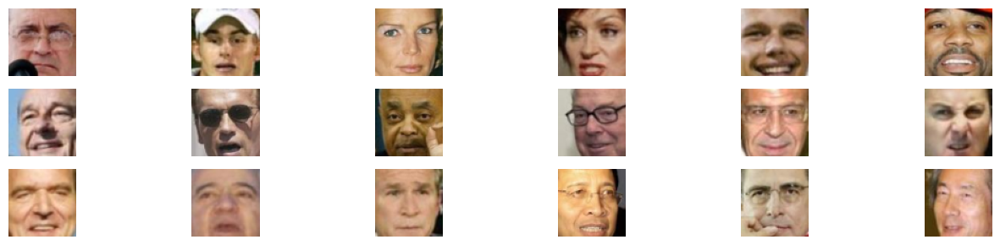

In [6]:
# imshow examples
rows, cols = 3, 6
images = ds_train[:rows*cols]
fig, axes = plt.subplots(rows, cols, figsize=(14, 3), tight_layout=True)
for ax, img in zip(axes.ravel(), images):
    ax.imshow(img)
    ax.axis('off')
plt.show()

## 1.2. Архитектура модели (1.5 балла)
В этом разделе мы напишем и обучем обычный автоэнкодер.



<img src="https://www.notion.so/image/https%3A%2F%2Fs3-us-west-2.amazonaws.com%2Fsecure.notion-static.com%2F4b8adf79-8e6a-4b7d-9061-8617a00edbb1%2F__2021-04-30__14.53.33.png?table=block&id=56f187b4-279f-4208-b1ed-4bda5f91bfc0&width=2880&userId=3b1b5e32-1cfb-4b0f-8705-5a524a8f56e3&cache=v2" alt="Autoencoder">


^ напомню, что автоэнкодер выглядит вот так

In [7]:
dim_code = 64  # выберите размер латентного вектора

Реализуем autoencoder. Архитектуру (conv, fully-connected, ReLu, etc) можете выбирать сами. Экспериментируйте!

In [8]:
class Autoencoder(nn.Module):
    def __init__(self):
        super().__init__()
        self.encoder = nn.Sequential(
            nn.Conv2d(3, 64, 7, 2, 3),  # 64,64 -> 32,32
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=True),
            nn.Conv2d(64, 64, 7, 2, 3),  # 32,32 -> 16,16
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=True),
            nn.Conv2d(64, 64, 7, 2, 3),  # 16,16 -> 8,8
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=True),
            nn.Conv2d(64, 64, 7, 2, 3),  # 8,8 -> 4,4
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=True),
            nn.Conv2d(64, dim_code, 4, 1, 0),  # 4,4 -> 1,1
            nn.Flatten(),
        )
        self.decoder = nn.Sequential(
            nn.Unflatten(-1, (dim_code, 1, 1)),
            nn.ConvTranspose2d(dim_code, 64, 4, 1, 0),  # 1,1 -> 4,4
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=True),
            nn.ConvTranspose2d(64, 64, 6, 2, 2),  # 4,4 -> 8,8
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=True),
            nn.ConvTranspose2d(64, 64, 6, 2, 2),  # 8,8 -> 16,16
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=True),
            nn.ConvTranspose2d(64, 64, 6, 2, 2), # 16,16 -> 32,32
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=True),
            nn.ConvTranspose2d(64, 3, 6, 2, 2), # 32,32 -> 64,64
            nn.Sigmoid(),
        )

    def decode(self, z):
        x = self.decoder(z)
        return x

    def forward(self, x):
        z = self.encoder(x)
        x = self.decoder(z)
        return x, z


if __name__ == "__main__":
    # test the model_ae
    model_ae = Autoencoder()
    x_dumb = torch.randn([4, 3, 64, 64])
    y_dumb, z_dumb = model_ae(x_dumb)
    print(x_dumb.shape)
    print(z_dumb.shape)
    print(y_dumb.shape)
    del model_ae

torch.Size([4, 3, 64, 64])
torch.Size([4, 64])
torch.Size([4, 3, 64, 64])


## 1.3 Обучение (2 балла)

Осталось написать код обучения автоэнкодера. При этом было бы неплохо в процессе иногда смотреть, как автоэнкодер реконструирует изображения на данном этапе обучения. Наример, после каждой эпохи (прогона train выборки через автоэекодер) можно смотреть, какие реконструкции получились для каких-то изображений val выборки.

А, ну еще было бы неплохо выводить графики train и val лоссов в процессе тренировки =)

In [9]:
def initialize_weights(model):
    for m in model.modules():
        if isinstance(m, nn.Conv2d):
            nn.init.kaiming_normal_(m.weight.data, nonlinearity="relu")
        elif isinstance(m, nn.BatchNorm2d):
            m.weight.data.fill_(1.0)
            m.bias.data.fill_(1e-4)
        elif isinstance(m, nn.Linear):
            m.weight.data.normal_(0.0, 0.0001)
            m.bias.data.zero_()
    return model

In [10]:
is_training = False

device = 'cuda:0'
model = autoencoder = Autoencoder().to(device)
model_name = model.__class__.__name__
model = initialize_weights(model)
optimizer = torch.optim.AdamW(model.parameters(), lr=3e-4)
loss_fn = nn.MSELoss(reduction='mean')
global_step = 0
global_history = {
    'train': defaultdict(list),
    'valid': defaultdict(list),
}

if is_training:
    for epoch in range(1, 250+1):

        # --------- TRAIN STAGE ------------
        stage = 'train'
        history = defaultdict(list)
        model.train(True)
        for image in dl_train:
            image = image.permute(0, 3, 1, 2).float().to(device)
            image_out, z = model(image)
            loss = loss_fn(image_out, image)
            optimizer.zero_grad() # clear gradients for this training step
            loss.backward() # backpropagation, compute gradients
            optimizer.step() # apply gradients
            history["loss"].append(loss.cpu().detach().numpy())
            # printing
            # if global_step % 200 == 0:
            #     print(f"Epoch: {epoch:04d}, gs: {global_step:06d}, loss: {history['loss'][-1]:.6f}")
            global_step += 1

        # fill the global history
        if epoch % 1 == 0:
            global_history[stage]['epoch'].append(epoch)
            global_history[stage]['loss_avg'].append(np.mean(history['loss']))

        # printing
        if epoch % 10 == 0:
            print(f"Epoch: {epoch:04d}, stage: {stage}, loss_avg: {global_history[stage]['loss_avg'][-1]:.6f}")

        # --------- VALIDATION STAGE ------------
        stage = 'valid'
        history = defaultdict(list)
        model.train(False)
        with torch.no_grad():
            for image in dl_valid:
                image = image.permute(0, 3, 1, 2).float().to(device)
                image_out, z = model(image)
                loss = loss_fn(image_out, image)
                history["loss"].append(loss.cpu().detach().numpy())

        # fill the global history
        if epoch % 1 == 0:
            global_history[stage]['epoch'].append(epoch)
            global_history[stage]['loss_avg'].append(np.mean(history['loss']))

        # printing
        if epoch % 50 == 0:
            print(f"Epoch: {epoch:04d}, stage: {stage}, loss_avg: {global_history[stage]['loss_avg'][-1]:.6f}")

        if epoch % 1 == 0:
            torch.save(model, f"models/{model_name}.pt")
            with open(f'history/{model_name}.hst', 'wb') as f:
                pickle.dump(global_history, f)
else:
    model = autoencoder = torch.load(f"models/{model_name}.pt", map_location=device)
    with open(f'history/{model_name}.hst', 'rb') as f:
            global_history = pickle.load(f)

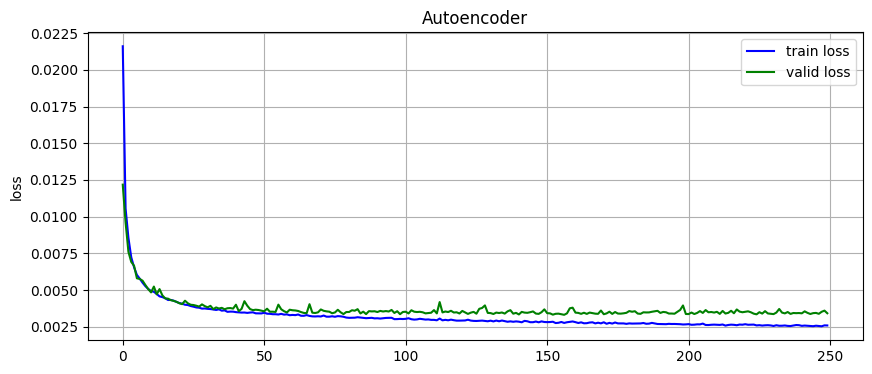

In [11]:
def plot_training(history, title=''):
    fig, ax = plt.subplots(1, 1, figsize=(10, 4))
    ax.plot(history['train']['loss_avg'], "b", label="train loss")
    ax.plot(history['valid']['loss_avg'], "g", label="valid loss")
    ax.legend(loc='best')
    ax.set_ylabel("loss")
    ax.set_title(title)
    ax.grid('on')
    plt.show()


plot_training(global_history, model_name)

Давайте посмотрим, как наш тренированный автоэекодер кодирует и восстанавливает картинки:

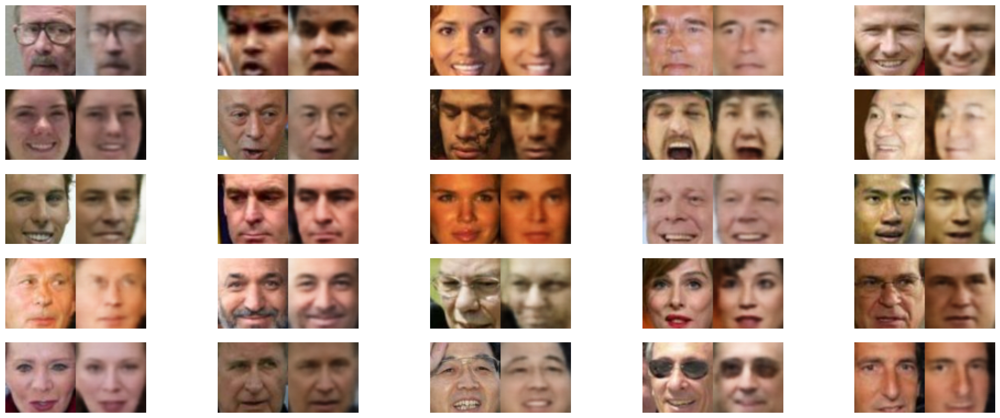

In [12]:
images_true = []
images_pred = []
with torch.no_grad():
    for step, image in enumerate(dl_valid):
        image = image.permute(0, 3, 1, 2).float().to(device)
        image_out, z = model(image)
        image_true = image[0,...].permute(1,2,0).cpu().detach().numpy()
        image_pred = image_out[0,...].permute(1,2,0).cpu().detach().numpy()
        images_true.append(image_true)
        images_pred.append(image_pred)
        if step==25:
            break

fig, axes = plt.subplots(5, 5, figsize=(25, 10))
for i, ax in enumerate(axes.ravel()):
    img_paired = np.concatenate([images_true[i], images_pred[i]], 1)
    ax.imshow(img_paired)
    ax.axis('off')
plt.show()

Not bad, right? 

## 1.4. Sampling (2 балла)

Давайте теперь будем не просто брать картинку, прогонять ее через автоэекодер и получать реконструкцию, а попробуем создать что-то НОВОЕ

Давайте возьмем и подсунем декодеру какие-нибудь сгенерированные нами векторы (например, из нормального распределения) и посмотрим на результат реконструкции декодера:

__Подсказка:__Е сли вместо лиц у вас выводится непонятно что, попробуйте посмотреть, как выглядят латентные векторы картинок из датасета. Так как в обучении нейронных сетей есть определенная доля рандома, векторы латентного слоя могут быть распределены НЕ как `np.random.randn(25, <latent_space_dim>)`. А чтобы у нас получались лица при запихивании вектора декодеру, вектор должен быть распределен так же, как латентные векторы реальных фоток. Так что в таком случае придется рандом немного подогнать.

In [13]:
# вычислим латентные статистики
def latent_moments(model, images):
    latents = []
    model.train(False)
    with torch.no_grad():
        for img in images:
            img = torch.Tensor(img).unsqueeze(0)
            img = img.permute(0, 3, 1, 2).float().to(device)
            out = model.encoder(img)
            latents.append(out.cpu().detach().numpy())
    return np.mean(latents, 0), np.std(latents, 0)

mean, std = latent_moments(model, ds_valid)
mean = torch.Tensor(mean)
std = torch.Tensor(std)
print(mean.shape)
print(std.shape)

torch.Size([1, 64])
torch.Size([1, 64])


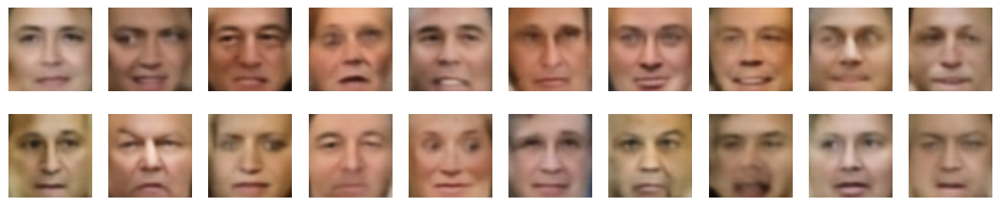

In [14]:
# сгенерируем 25 рандомных векторов размера latent_space
model.train(False)
with torch.no_grad():
    # z_batch = torch.rand(25, dim_code).float().to(device)
    z_tensors = [torch.normal(mean, 2/3 * std) for _ in range(25)]
    z_batch = torch.concatenate(z_tensors, 0).float().to(device)
    out = model.decoder(z_batch)
    images = out.permute(0, 2, 3, 1).detach().cpu().numpy()


fig, axes = plt.subplots(2, 10, figsize=(15, 3))
for i, ax in enumerate(axes.ravel()):
    ax.imshow(images[i, ...])
    ax.axis('off')
plt.show()

## 1.5 Time to make fun! (4 балла)

Давайте научимся пририсовывать людям улыбки =)

<img src="https://i.imgur.com/tOE9rDK.png" alt="linear" width="700" height="400">

План такой:

1. Нужно выделить "вектор улыбки": для этого нужно из выборки изображений найти несколько (~15) людей с улыбками и столько же без.

Найти людей с улыбками вам поможет файл с описанием датасета, скачанный вместе с датасетом. В нем указаны имена картинок и присутствубщие атрибуты (улыбки, очки...)

2. Вычислить латентный вектор для всех улыбающихся людей (прогнать их через encoder) и то же для всех грустненьких

3. Вычислить, собственно, вектор улыбки -- посчитать разность между средним латентным вектором улыбающихся людей и средним латентным вектором грустных людей

4. А теперь приделаем улыбку грустному человеку: добавим полученный в пункте 3 вектор к латентному вектору грустного человека и прогоним полученный вектор через decoder. Получим того же человека, но уже не грустненького!

Quiantity: 342
Quiantity: 254

SMILING


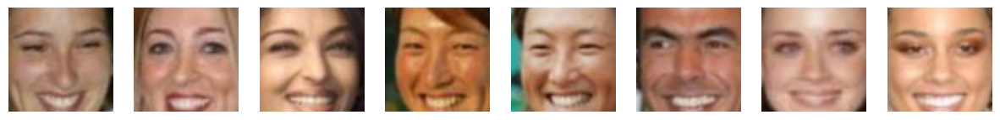

SADDING


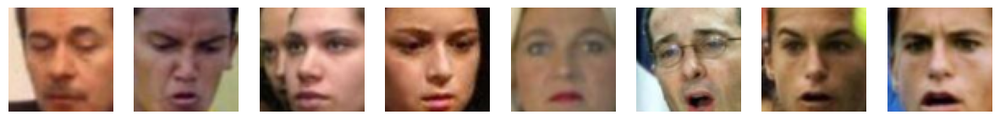

In [15]:
# Выберем из данных лица с улыбкой и "анти" улыбкой

threshold = 2.0
items_smiling = attrs["Smiling"] > threshold
items_sadding = attrs["Smiling"] < -threshold
print(f"Quiantity: {items_smiling.sum()}")
print(f"Quiantity: {items_sadding.sum()}\n")

images_smiling = data[items_smiling]
print("SMILING")
fig, axes = plt.subplots(1, 8, figsize=(15, 2))
for i, ax in enumerate(axes.ravel()):
    ax.imshow(images_smiling[i, ...])
    ax.axis('off')
plt.show()

images_sadding = data[items_sadding]
print("SADDING")
fig, axes = plt.subplots(1, 8, figsize=(15, 2))
for i, ax in enumerate(axes.ravel()):
    ax.imshow(images_sadding[i, ...])
    ax.axis('off')
plt.show()

In [16]:
# вычислим латентный вектор улыбки
mean_imgs_smile, _ = latent_moments(model, images_smiling)
mean_imgs_sadly, _ = latent_moments(model, images_sadding)

latent_smile = mean_imgs_smile - mean_imgs_sadly

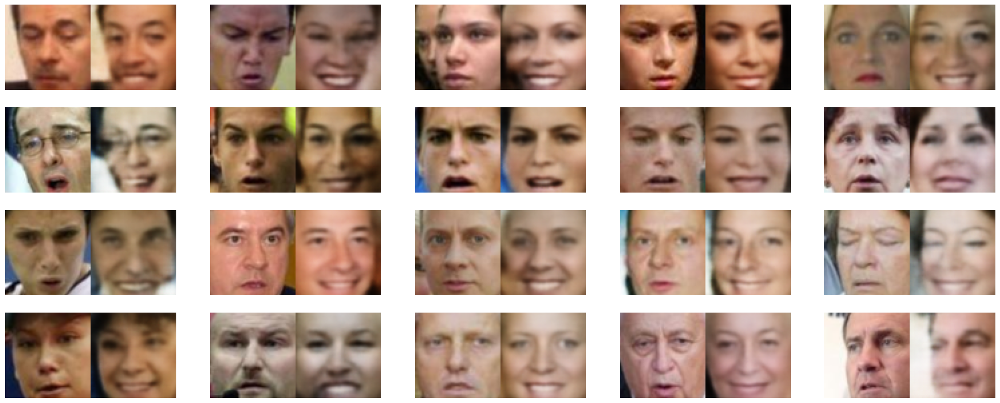

In [17]:
# добавим грустному человеку улыбку
latent_smile = torch.Tensor(latent_smile).to(device)
images_true = []
images_pred = []
with torch.no_grad():
    for img in images_sadding:
        img = torch.Tensor(img).unsqueeze(0)
        img = img.permute(0, 3, 1, 2).float().to(device)
        z = model.encoder(img)
        new_z = z + latent_smile
        out = model.decoder(new_z)
        image_true = img[0,...].permute(1,2,0).cpu().detach().numpy()
        image_pred = out[0,...].permute(1,2,0).cpu().detach().numpy()
        images_true.append(image_true)
        images_pred.append(image_pred)

fig, axes = plt.subplots(4, 5, figsize=(25, 10))
for i, ax in enumerate(axes.ravel()):
    img_paired = np.concatenate([images_true[i], images_pred[i]], 1)
    ax.imshow(img_paired)
    ax.axis('off')
plt.show()


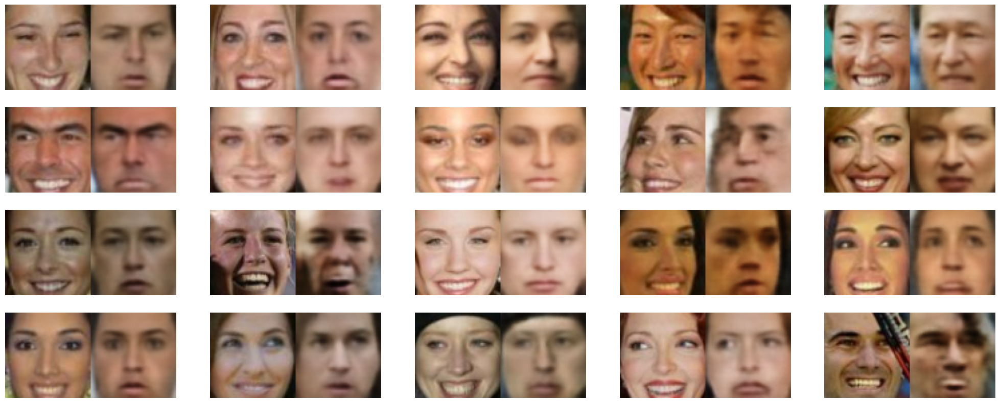

In [18]:
# уберём улыбку у улыбающего человека
latent_smile = torch.Tensor(latent_smile).to(device)
images_true = []
images_pred = []
with torch.no_grad():
    for img in images_smiling:
        img = torch.Tensor(img).unsqueeze(0)
        img = img.permute(0, 3, 1, 2).float().to(device)
        z = model.encoder(img)
        new_z = z - latent_smile
        out = model.decoder(new_z)
        image_true = img[0,...].permute(1,2,0).cpu().detach().numpy()
        image_pred = out[0,...].permute(1,2,0).cpu().detach().numpy()
        images_true.append(image_true)
        images_pred.append(image_pred)

fig, axes = plt.subplots(4, 5, figsize=(25, 10))
for i, ax in enumerate(axes.ravel()):
    img_paired = np.concatenate([images_true[i], images_pred[i]], 1)
    ax.imshow(img_paired)
    ax.axis('off')
plt.show()


Вуаля! Вы восхитительны!

Теперь вы можете пририсовывать людям не только улыбки, но и много чего другого -- закрывать/открывать глаза, пририсовывать очки... в общем, все, на что хватит фантазии и на что есть атрибуты в `all_attrs`:)

# Часть 2: Variational Autoencoder (10 баллов) 

Займемся обучением вариационных автоэнкодеров — проапгрейженной версии AE. Обучать будем на датасете MNIST, содержащем написанные от руки цифры от 0 до 9

In [19]:
import torchvision as tv

batch_size = 256
# MNIST Dataset
train_dataset = datasets.MNIST(root='./mnist_data/', train=True, transform=tv.transforms.ToTensor(), download=True)
test_dataset = datasets.MNIST(root='./mnist_data/', train=False, transform=tv.transforms.ToTensor(), download=False)

# Data Loader (Input Pipeline)
train_loader = torch.utils.data.DataLoader(dataset=train_dataset, batch_size=batch_size, shuffle=True)
test_loader = torch.utils.data.DataLoader(dataset=test_dataset, batch_size=batch_size, shuffle=False)

## 2.1 Архитектура модели и обучение (2 балла)

Реализуем VAE. Архитектуру (conv, fully-connected, ReLu, etc) можете выбирать сами. Рекомендуем пользоваться более сложными моделями, чем та, что была на семинаре:) Экспериментируйте!

In [20]:
def get_device(module):
    return next(module.parameters()).device

In [21]:
class VAE(nn.Module):
    def __init__(self, latent_dim=8):
        super().__init__()
        self.latent_dim = latent_dim
        self.encoder = nn.Sequential(
            nn.Conv2d(1, 32, 5, 2, 3),  # 28,28 -> 16,16
            nn.BatchNorm2d(32),
            nn.ReLU(inplace=True),
            nn.Conv2d(32, 32, 5, 2, 2),  # 16,16 -> 8,8
            nn.BatchNorm2d(32),
            nn.ReLU(inplace=True),
            nn.Conv2d(32, 32, 5, 2, 2),  # 8,8 -> 4,4
            nn.BatchNorm2d(32),
            nn.ReLU(inplace=True),
            nn.Conv2d(32, self.latent_dim * 2, 4, 1, 0),  # 4,4 -> 1,1
            nn.Flatten(),
        )
        self.decoder = nn.Sequential(
            nn.Unflatten(-1, (self.latent_dim, 1, 1)),
            nn.ConvTranspose2d(self.latent_dim, 32, 4, 1, 0),  # 1,1 -> 4,4
            nn.BatchNorm2d(32),
            nn.ReLU(inplace=True),
            nn.ConvTranspose2d(32, 32, 4, 2, 1),  # 4,4 -> 8,8
            nn.BatchNorm2d(32),
            nn.ReLU(inplace=True),
            nn.ConvTranspose2d(32, 32, 4, 2, 1),  # 8,8 -> 16,16
            nn.BatchNorm2d(32),
            nn.ReLU(inplace=True),
            nn.ConvTranspose2d(32, 1, 4, 2, 3), # 32,32 -> 28,28
            nn.Sigmoid(),
        )

    def reparameterize(self, mu, logsigma):
        # std = torch.exp(0.5 * logsigma)
        std = torch.exp(0.5*logsigma)
        eps = torch.randn_like(std)
        sample = (mu + eps * std)
        # sample = torch.normal(mean=mu, std=std)
        return sample
    
    def encode(self, x):
        x = self.encoder(x) 
        mu, logsigma = torch.split(x, self.latent_dim, dim=1)
        return mu, logsigma
    
    def decode(self, z):
        return self.decoder(z)

    def forward(self, x):
        mu, logsigma = self.encode(x)
        z = self.reparameterize(mu, logsigma)
        reconstruct = self.decode(z)
        return reconstruct, mu, logsigma


if __name__ == "__main__":
    model_vae = VAE()
    x_dumb = torch.randn([4, 1, 28, 28])
    y_dumb, mu, logsigma = model_vae(x_dumb)
    print(x_dumb.shape)
    print(z_dumb.shape)
    print(y_dumb.shape)
    del model_vae

torch.Size([4, 1, 28, 28])
torch.Size([4, 64])
torch.Size([4, 1, 28, 28])


Определим лосс и его компоненты для VAE:

Надеюсь, вы уже прочитали материал в towardsdatascience (или еще где-то) про VAE и знаете, что лосс у VAE состоит из двух частей: KL и log-likelihood.

Общий лосс будет выглядеть так:

$$\mathcal{L} = -D_{KL}(q_{\phi}(z|x)||p(z)) + \log p_{\theta}(x|z)$$

Формула для KL-дивергенции:

$$D_{KL} = -\frac{1}{2}\sum_{i=1}^{dimZ}(1+log(\sigma_i^2)-\mu_i^2-\sigma_i^2)$$

В качестве log-likelihood возьмем привычную нам кросс-энтропию.

In [22]:
def KL_divergence(mu, logsigma):
    """
    часть функции потерь, которая отвечает за "близость" латентных представлений разных людей
    """
    # Kingma and Welling. Auto-Encoding Variational Bayes. ICLR, 2014
	# https://arxiv.org/abs/1312.6114
	# - 0.5 * sum(1 + log(sigma^2) - mu^2 - sigma^2)
    loss = - 0.5 * torch.sum(1 + logsigma - mu**2 - logsigma.exp())
    return loss

def log_likelihood(reconstruction, x):
    """
    часть функции потерь, которая отвечает за качество реконструкции (как mse в обычном autoencoder)
    """
    loss = F.binary_cross_entropy(reconstruction, x, reduction='sum')
    # loss = F.mse_loss(reconstruction, x, reduction='sum')
    return loss

def loss_vae(reconstruction, x, mu, logsigma, beta=1):
    LL = log_likelihood(reconstruction, x, reduction='sum')
    KL = KL_divergence(mu, logsigma)
    loss = LL + beta * KL
    return loss


def loss_func(reconstruction, x, mu, logsigma, beta=1):
    # LL = F.mse_loss(reconstruction, x, reduction='sum')
    LL = F.binary_cross_entropy(reconstruction, x, reduction='sum')
    KL = - 0.5 * torch.sum(1 + logsigma - mu.pow(2) - logsigma.exp())
    loss = LL + beta * KL
    return loss.mean()

И обучим модель:

In [23]:
is_training = False

device = 'cuda:0'
model = vae = VAE().to(device)
model_name = model.__class__.__name__
model = initialize_weights(model)
optimizer = torch.optim.AdamW(model.parameters(), lr=1e-3)
loss_fn = loss_func
global_step = 0
global_history = {
    'train': defaultdict(list),
    'valid': defaultdict(list),
}

if is_training:
    for epoch in range(1, 250+1):

        # --------- TRAIN STAGE ------------
        stage = 'train'
        history = defaultdict(list)
        model.train(True)
        # for image in dl_train:
        for image, label in train_loader:
            image = image.float().to(device)
            reconstruction, mu, logsigma = model(image)
            loss = loss_fn(reconstruction, image, mu, logsigma)
            optimizer.zero_grad() # clear gradients for this training step
            loss.backward() # backpropagation, compute gradients
            optimizer.step() # apply gradients
            history["loss"].append(loss.cpu().detach().numpy())
            global_step += 1

        # fill the global history
        if epoch % 1 == 0:
            global_history[stage]['epoch'].append(epoch)
            global_history[stage]['loss_avg'].append(np.mean(history['loss']))

        # printing
        if epoch % 10 == 0:
            print(f"{stage.upper()}. Epoch: {epoch:04d}, loss_avg: {global_history[stage]['loss_avg'][-1]:.6f}")

        # --------- VALIDATION STAGE ------------
        stage = 'valid'
        history = defaultdict(list)
        model.train(False)
        with torch.no_grad():
            for image, label in test_loader:
                image = image.float().to(device)
                reconstruction, mu, logsigma = model(image)
                loss = loss_fn(reconstruction, image, mu, logsigma)
                history["loss"].append(loss.cpu().detach().numpy())

        # fill the global history
        if epoch % 1 == 0:
            global_history[stage]['epoch'].append(epoch)
            global_history[stage]['loss_avg'].append(np.mean(history['loss']))

        # printing
        if epoch % 50 == 0:
            print(f"{stage.upper()}. Epoch: {epoch:04d}, loss_avg: {global_history[stage]['loss_avg'][-1]:.6f}")

        if epoch % 1 == 0:
            torch.save(model, f"models/{model_name}.pt")
            with open(f'history/{model_name}.hst', 'wb') as f:
                pickle.dump(global_history, f)
else:
    model = vae = torch.load(f"models/{model_name}.pt", map_location=device)
    with open(f'history/{model_name}.hst', 'rb') as f:
            global_history = pickle.load(f)

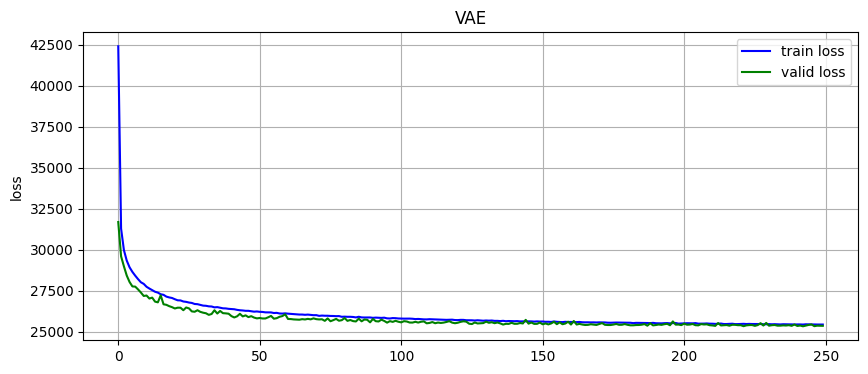

In [24]:
plot_training(global_history, model_name)

Давайте посмотрим, как наш тренированный VAE кодирует и восстанавливает картинки:

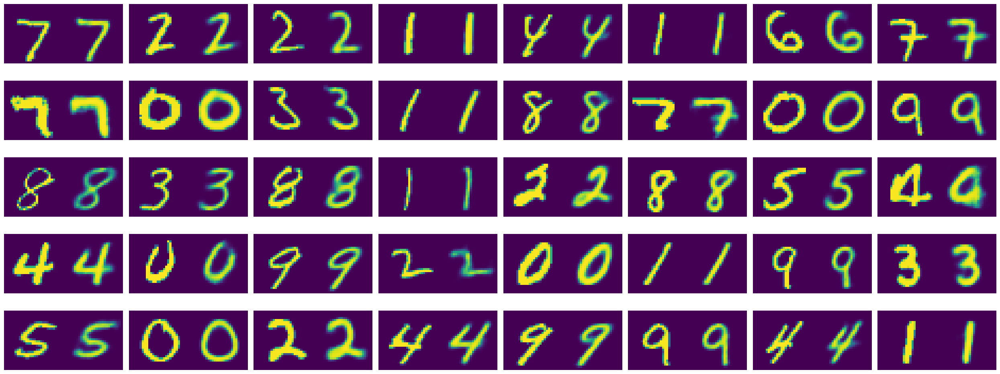

In [25]:
images_true = []
images_pred = []

model.train(False)
with torch.no_grad():
    for step, (image, label) in enumerate(test_loader):
        image = image.float().to(device)
        reconstruction, mu, logsigma = model(image)
        loss = loss_fn(reconstruction, image, mu, logsigma)
        image_true = image[0,...].permute(1,2,0).cpu().detach().numpy()
        image_pred = reconstruction[0,...].permute(1,2,0).cpu().detach().numpy()
        images_true.append(image_true)
        images_pred.append(image_pred)
        if step==40:
            break

fig, axes = plt.subplots(5, 8, figsize=(25, 10))
for i, ax in enumerate(axes.ravel()):
    img_paired = np.concatenate([images_true[i], images_pred[i]], 1)
    ax.imshow(img_paired)
    ax.axis('off')
plt.tight_layout()
plt.show()

Давайте попробуем проделать для VAE то же, что и с обычным автоэнкодером -- подсунуть decoder'у из VAE случайные векторы из нормального распределения и посмотреть, какие картинки получаются:

In [26]:
# вычислим латентные статистики
def latent_moments(model, images):
    latents = []
    model.train(False)
    with torch.no_grad():
        for img in images:
            img = torch.Tensor(img).unsqueeze(0)
            img = img.float().to(device)
            mu, logsigma = model.encode(img)
            z = model.reparameterize(mu, logsigma)
            latents.append(z.cpu().detach().numpy())
    latents = np.concatenate(latents, axis=0)
    mean = np.mean(latents, 0)[None, ...]
    std = np.std(latents, 0)[None, ...]
    return latents, mean, std

batch, labels = next(iter(test_loader))
images = [batch[i,...] for i in range(batch.shape[0])]
latents, mean, std = latent_moments(model, images)
mean = torch.Tensor(mean)
std = torch.Tensor(std)
print(latents.shape)
print(mean.shape)
print(std.shape)

(256, 8)
torch.Size([1, 8])
torch.Size([1, 8])


torch.Size([25, 8])


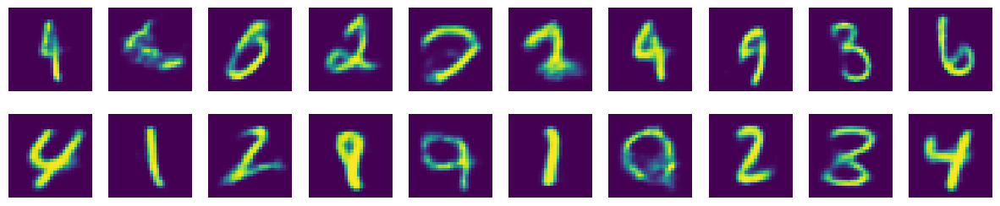

In [27]:
# сгенерируем 20 рандомных векторов размера latent_space
model.train(False)
with torch.no_grad():
    # z = torch.rand(16, 8).float().to(device)
    z_tensors = [torch.normal(mean=mean, std=std) for _ in range(25)]
    z_batch = torch.concatenate(z_tensors, 0).float().to(device)
    print(z_batch.shape)
    # z = model.reparameterize(mu, logsigma)
    out = model.decode(z_batch)
    images = out.permute(0, 2, 3, 1).detach().cpu().numpy()


fig, axes = plt.subplots(2, 10, figsize=(15, 3))
for i, ax in enumerate(axes.ravel()):
    ax.imshow(images[i, ...])
    ax.axis('off')
plt.show()

## 2.2. Latent Representation (2 балла)

Давайте посмотрим, как латентные векторы картинок лиц выглядят в пространстве.
Ваша задача -- изобразить латентные векторы картинок точками в двумерном просторанстве. 

Это позволит оценить, насколько плотно распределены латентные векторы изображений цифр в пространстве. 

Плюс давайте сделаем такую вещь: покрасим точки, которые соответствуют картинкам каждой цифры, в свой отдельный цвет

Подсказка: красить -- это просто =) У plt.scatter есть параметр c (color), см. в документации.


Итак, план:
1. Получить латентные представления картинок тестового датасета
2. С помощтю `TSNE` (есть в `sklearn`) сжать эти представления до размерности 2 (чтобы можно было их визуализировать точками в пространстве)
3. Визуализировать полученные двумерные представления с помощью `matplotlib.scatter`, покрасить разными цветами точки, соответствующие картинкам разных цифр.

In [28]:
N_samples = 5000
subset = torch.utils.data.Subset(test_dataset, list(range(N_samples)))
samples = [(batch, labels) for batch, labels in subset]
batches, labels = zip(*samples)
batches = np.stack(batches, axis=0)
Z, _, _ = latent_moments(model, batches)
print(Z.shape)

(5000, 8)


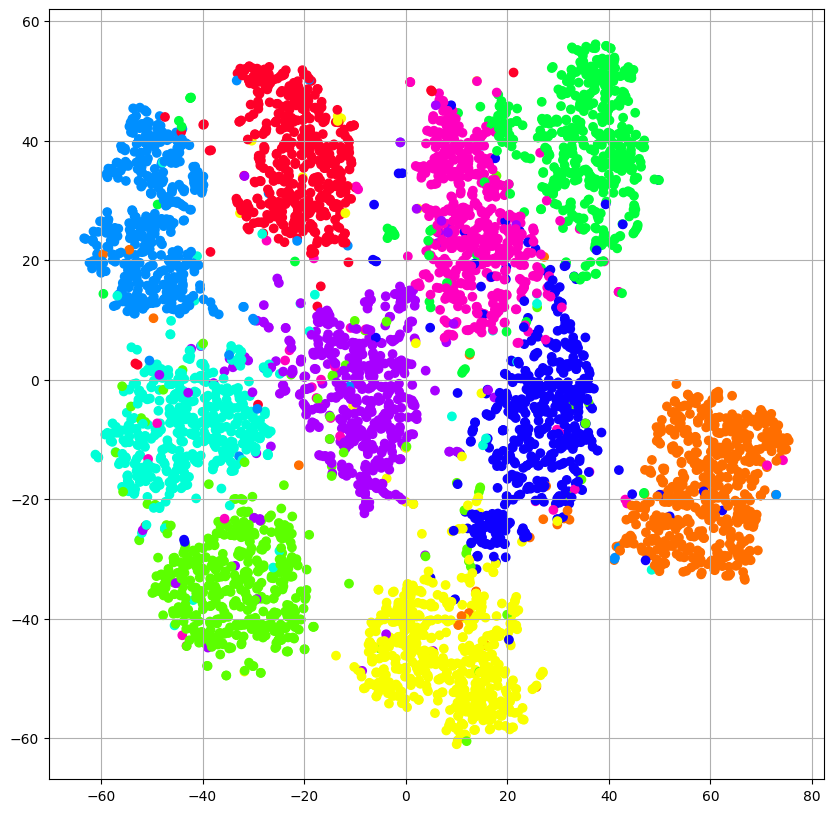

In [29]:
z_low = torch.from_numpy(TSNE(n_components=2).fit_transform(Z))

plt.figure(figsize=(10, 10))
plt.grid('on')
plt.scatter(z_low[:, 0], z_low[:, 1], c=labels, cmap='gist_rainbow')
plt.show()

Что вы думаете о виде латентного представления?

__Congrats v2.0!__

## 2.3. Conditional VAE (6 баллов)


Мы уже научились обучать обычный AE на датасете картинок и получать новые картинки, используя генерацию шума и декодер. 
Давайте теперь допустим, что мы обучили AE на датасете MNIST и теперь хотим генерировать новые картинки с числами с помощью декодера (как выше мы генерили рандомные лица). 
И вот нам понадобилось сгенерировать цифру 8, и мы подставляем разные варианты шума, но восьмерка никак не генерится:(

Хотелось бы добавить к нашему AE функцию "выдай мне рандомное число из вот этого вот класса", где классов десять (цифры от 0 до 9 образуют десять классов).  Conditional AE — так называется вид автоэнкодера, который предоставляет такую возможность. Ну, название "conditional" уже говорит само за себя.

И в этой части задания мы научимся такие обучать.

### Архитектура

На картинке ниже представлена архитектура простого Conditional VAE.

По сути, единственное отличие от обычного -- это то, что мы вместе с картинкой в первом слое энкодера и декодера передаем еще информацию о классе картинки. 

То есть, в первый (входной) слой энкодера подается конкатенация картинки и информации о классе (например, вектора из девяти нулей и одной единицы). В первый слой декодера подается конкатенация латентного вектора и информации о классе.


![alt text](https://sun9-63.userapi.com/impg/Mh1akf7mfpNoprrSWsPOouazSmTPMazYYF49Tw/djoHNw_9KVA.jpg?size=1175x642&quality=96&sign=e88baec5f9bb91c8443fba31dcf0a4df&type=album)

![alt text](https://sun9-73.userapi.com/impg/UDuloLNKhzTBYAKewgxke5-YPsAKyGOqA-qCRg/MnyCavJidxM.jpg?size=1229x651&quality=96&sign=f2d21bfacc1c5755b76868dc4cfef39c&type=album)



На всякий случай: это VAE, то есть, latent у него все еще состоит из mu и sigma

Таким образом, при генерации новой рандомной картинки мы должны будем передать декодеру сконкатенированные латентный вектор и класс картинки.

P.S. Также можно передавать класс картинки не только в первый слой, но и в каждый слой сети. То есть на каждом слое конкатенировать выход из предыдущего слоя и информацию о классе.

In [30]:
class CVAE(nn.Module):
    def __init__(self, latent_dim=8, latent_classes=10):
        super().__init__()
        self.latent_dim = latent_dim
        self.latent_classes = latent_classes
        self.encoder = nn.Sequential(
            nn.Conv2d(1, 32, 5, 2, 3),  # 28,28 -> 16,16
            nn.BatchNorm2d(32),
            nn.ReLU(inplace=True),
            nn.Conv2d(32, 32, 5, 2, 2),  # 16,16 -> 8,8
            nn.BatchNorm2d(32),
            nn.ReLU(inplace=True),
            nn.Conv2d(32, 32, 5, 2, 2),  # 8,8 -> 4,4
            nn.BatchNorm2d(32),
            nn.ReLU(inplace=True),
            nn.Conv2d(32, self.latent_dim * 2, 4, 1, 0),  # 4,4 -> 1,1
            nn.Flatten(),
        )
        self.decoder = nn.Sequential(
            nn.Unflatten(-1, (self.latent_dim+self.latent_classes, 1, 1)),
            nn.ConvTranspose2d(self.latent_dim+self.latent_classes, 32, 4, 1, 0),  # 1,1 -> 4,4
            nn.BatchNorm2d(32),
            nn.ReLU(inplace=True),
            nn.ConvTranspose2d(32, 32, 4, 2, 1),  # 4,4 -> 8,8
            nn.BatchNorm2d(32),
            nn.ReLU(inplace=True),
            nn.ConvTranspose2d(32, 32, 4, 2, 1),  # 8,8 -> 16,16
            nn.BatchNorm2d(32),
            nn.ReLU(inplace=True),
            nn.ConvTranspose2d(32, 1, 4, 2, 3), # 32,32 -> 28,28
            nn.Sigmoid(),
        )

    def reparameterize(self, mu, logsigma):
        std = torch.exp(0.5*logsigma)
        eps = torch.randn_like(std)
        sample = (mu + eps * std)
        return sample
    
    def encode(self, x):
        x = self.encoder(x) 
        mu, logsigma = torch.split(x, self.latent_dim, dim=1)
        return mu, logsigma
    
    def decode(self, z, conditional):
        z = torch.concatenate((z, conditional), axis=1)
        return self.decoder(z)

    def forward(self, x, conditional):
        mu, logsigma = self.encode(x)
        z = self.reparameterize(mu, logsigma)
        reconstruct = self.decode(z, conditional)
        return reconstruct, mu, logsigma


if __name__ == "__main__":
    bs = 4
    num_classes = 10
    model = CVAE(latent_dim=8, latent_classes=10)
    x_dumb = torch.randn([bs, 1, 28, 28])
    c_dumb = np.array(range(bs)) % num_classes
    c_dumb = torch.nn.functional.one_hot(torch.as_tensor(c_dumb), num_classes=num_classes)
    y_dumb, mu, logsigma = model(x_dumb, c_dumb)
    print(x_dumb.shape)
    print(mu.shape)
    print(logsigma.shape)
    print(label.shape)
    print(c_dumb.shape)
    del model

torch.Size([4, 1, 28, 28])
torch.Size([4, 8])
torch.Size([4, 8])
torch.Size([16])
torch.Size([4, 10])


In [31]:
is_training = False

device = 'cuda:0'
model = cvae = CVAE().to(device)
model_name = model.__class__.__name__
model = initialize_weights(model)
optimizer = torch.optim.AdamW(model.parameters(), lr=1e-3)
loss_fn = loss_func
global_step = 0
global_history = {
    'train': defaultdict(list),
    'valid': defaultdict(list),
}

if is_training:
    for epoch in range(1, 250+1):

        # --------- TRAIN STAGE ------------
        stage = 'train'
        history = defaultdict(list)
        model.train(True)
        # for image in dl_train:
        for image, label in train_loader:
            image = image.float().to(device)
            label = torch.nn.functional.one_hot(label, num_classes=10).to(device)
            reconstruction, mu, logsigma = model(image, label)
            loss = loss_fn(reconstruction, image, mu, logsigma)
            optimizer.zero_grad() # clear gradients for this training step
            loss.backward() # backpropagation, compute gradients
            optimizer.step() # apply gradients
            history["loss"].append(loss.cpu().detach().numpy())
            global_step += 1

        # fill the global history
        if epoch % 1 == 0:
            global_history[stage]['epoch'].append(epoch)
            global_history[stage]['loss_avg'].append(np.mean(history['loss']))

        # printing
        if epoch % 10 == 0:
            print(f"{stage.upper()}. Epoch: {epoch:04d}, loss_avg: {global_history[stage]['loss_avg'][-1]:.6f}")

        # --------- VALIDATION STAGE ------------
        stage = 'valid'
        history = defaultdict(list)
        model.train(False)
        with torch.no_grad():
            for image, label in test_loader:
                image = image.float().to(device)
                label = torch.nn.functional.one_hot(label, num_classes=10).to(device)
                reconstruction, mu, logsigma = model(image, label)
                loss = loss_fn(reconstruction, image, mu, logsigma)
                history["loss"].append(loss.cpu().detach().numpy())

        # fill the global history
        if epoch % 1 == 0:
            global_history[stage]['epoch'].append(epoch)
            global_history[stage]['loss_avg'].append(np.mean(history['loss']))

        # printing
        if epoch % 50 == 0:
            print(f"{stage.upper()}. Epoch: {epoch:04d}, loss_avg: {global_history[stage]['loss_avg'][-1]:.6f}")

        if epoch % 1 == 0:
            torch.save(model, f"models/{model_name}.pt")
            with open(f'history/{model_name}.hst', 'wb') as f:
                pickle.dump(global_history, f)
else:
    model = vae = torch.load(f"models/{model_name}.pt", map_location=device)
    with open(f'history/{model_name}.hst', 'rb') as f:
            global_history = pickle.load(f)

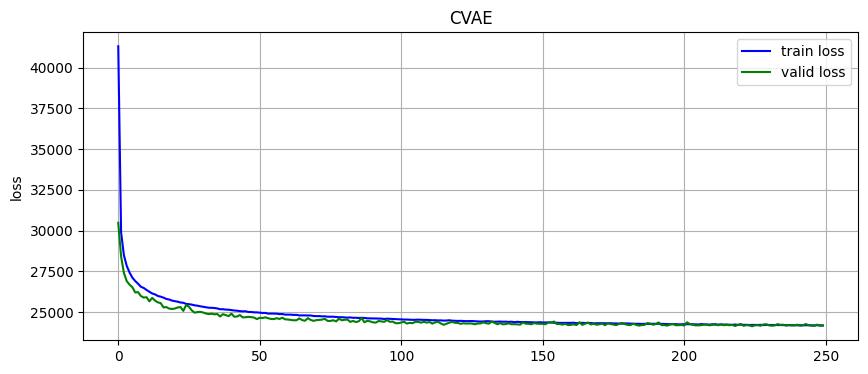

In [32]:
plot_training(global_history, model_name)

### Sampling


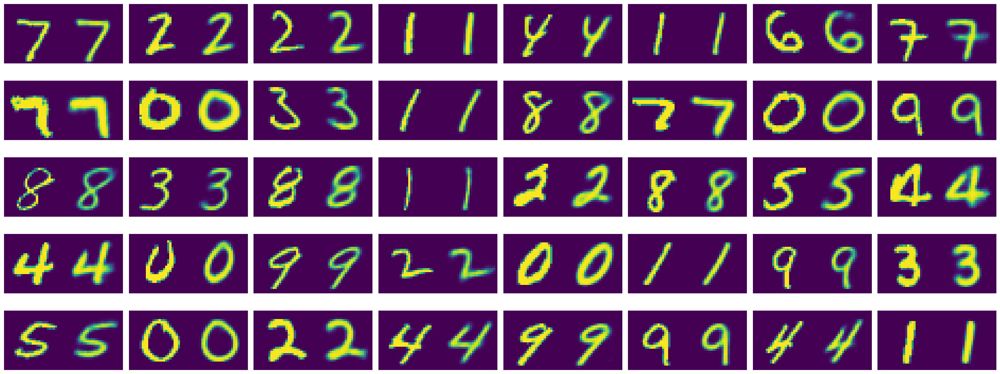

In [33]:
# позмотрим как восстанавливает
images_true = []
images_pred = []

model.train(False)
with torch.no_grad():
    for step, (image, label) in enumerate(test_loader):
        image = image.float().to(device)
        label = torch.nn.functional.one_hot(label, num_classes=10).to(device)
        reconstruction, mu, logsigma = model(image, label)
        loss = loss_fn(reconstruction, image, mu, logsigma)
        image_true = image[0,...].permute(1,2,0).cpu().detach().numpy()
        image_pred = reconstruction[0,...].permute(1,2,0).cpu().detach().numpy()
        images_true.append(image_true)
        images_pred.append(image_pred)
        if step==40:
            break

fig, axes = plt.subplots(5, 8, figsize=(25, 10))
for i, ax in enumerate(axes.ravel()):
    img_paired = np.concatenate([images_true[i], images_pred[i]], 1)
    ax.imshow(img_paired)
    ax.axis('off')
plt.tight_layout()
plt.show()

Тут мы будем сэмплировать из CVAE. Это прикольнее, чем сэмплировать из простого AE/VAE: тут можно взять один и тот же латентный вектор и попросить CVAE восстановить из него картинки разных классов!
Для MNIST вы можете попросить CVAE восстановить из одного латентного вектора, например, картинки цифры 5 и 7.

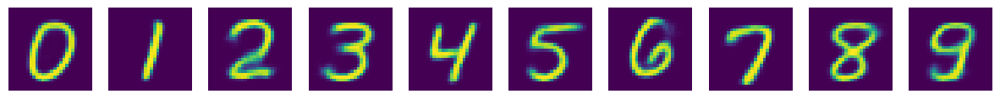

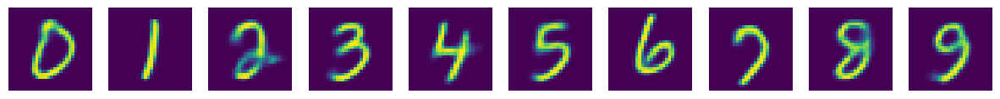

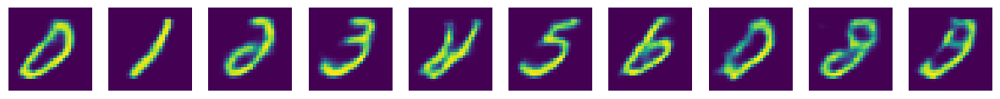

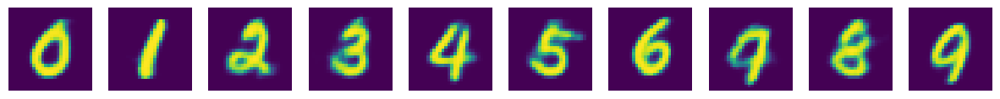

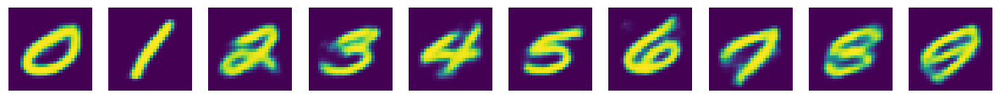

In [34]:
# сгенерируем из одного скрытого представления разные цифры - сделаем так 5 раз
# круто, что стиль сохраняется

for _ in range(5):
    z_tensor = torch.normal(mean=mean, std=std)
    labels = [0,1,2,3,4,5,6,7,8,9]
    model.train(False)
    with torch.no_grad():
        z_batch = torch.concatenate([z_tensor] * len(labels), 0).float().to(device)
        labels = torch.nn.functional.one_hot(torch.as_tensor(labels), num_classes=10).to(device)
        out = model.decode(z_batch, labels)
        images = out.permute(0, 2, 3, 1).detach().cpu().numpy()

    fig, axes = plt.subplots(1, 10, figsize=(15, 3))
    for i, ax in enumerate(axes.ravel()):
        ax.imshow(images[i, ...])
        ax.axis('off')
    plt.show()

Грандиозно!

Splendid! Вы великолепны!


### Latent Representations

Давайте посмотрим, как выглядит латентное пространство картинок в CVAE и сравним с картинкой для VAE =)

Опять же, нужно покрасить точки в разные цвета в зависимости от класса.

In [35]:
# соберем латентные представления
def latent_moments(model, images, labels):
    Z = []
    Z_with_C = []
    device = get_device(model)
    model.train(False)
    with torch.no_grad():
        for img, label in zip(images, labels):
            img = torch.Tensor(img).unsqueeze(0)
            img = img.float().to(device)
            label = torch.nn.functional.one_hot(torch.as_tensor(label), num_classes=10)
            label = label.unsqueeze(0).to(device)
            mu, logsigma = model.encode(img)
            z = model.reparameterize(mu, logsigma)
            z_with_c = torch.concatenate((z, label), axis=1)
            Z.append(z.cpu().detach().numpy())
            Z_with_C.append(z_with_c.cpu().detach().numpy())
    Z = np.concatenate(Z, axis=0)
    Z_with_C = np.concatenate(Z_with_C, axis=0)
    mean = np.mean(latents, 0)[None, ...]
    std = np.std(latents, 0)[None, ...]
    return Z, Z_with_C, mean, std

N_samples = 5000
subset = torch.utils.data.Subset(test_dataset, list(range(N_samples)))
samples = [(batch, labels) for batch, labels in subset]
images, labels = zip(*samples)
images = np.stack(images, axis=0)
Z, Z_with_C, _, _ = latent_moments(model, images, labels)
print(Z.shape)
print(Z_with_C.shape)

(5000, 8)
(5000, 18)


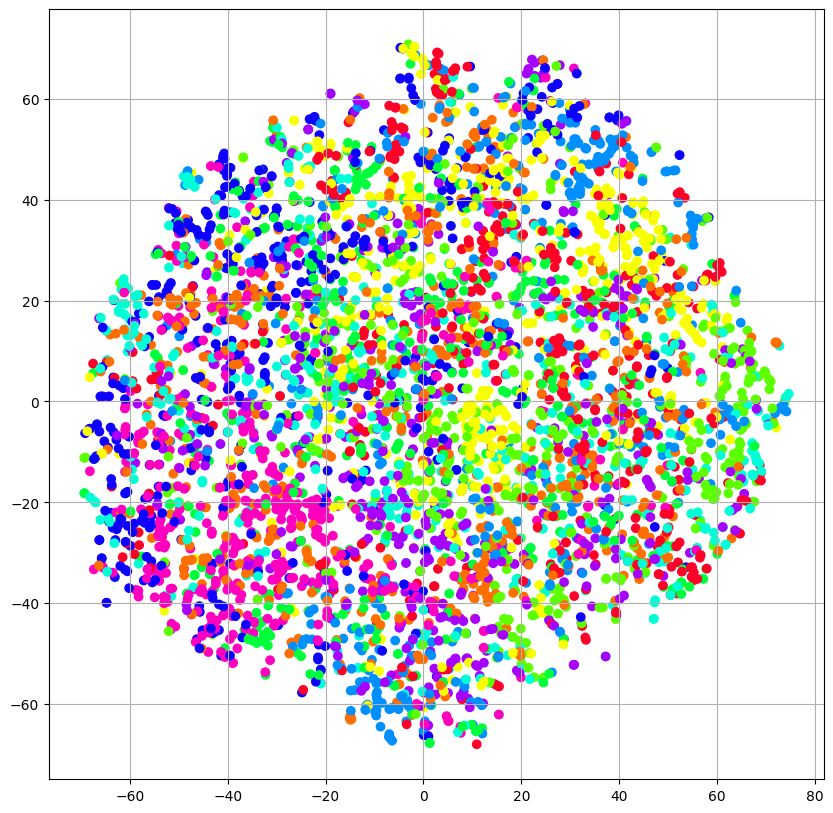

In [36]:
z_low = torch.from_numpy(TSNE(n_components=2).fit_transform(Z))

plt.figure(figsize=(10, 10))
plt.grid('on')
plt.scatter(z_low[:, 0], z_low[:, 1], c=labels, cmap='gist_rainbow')
plt.show()

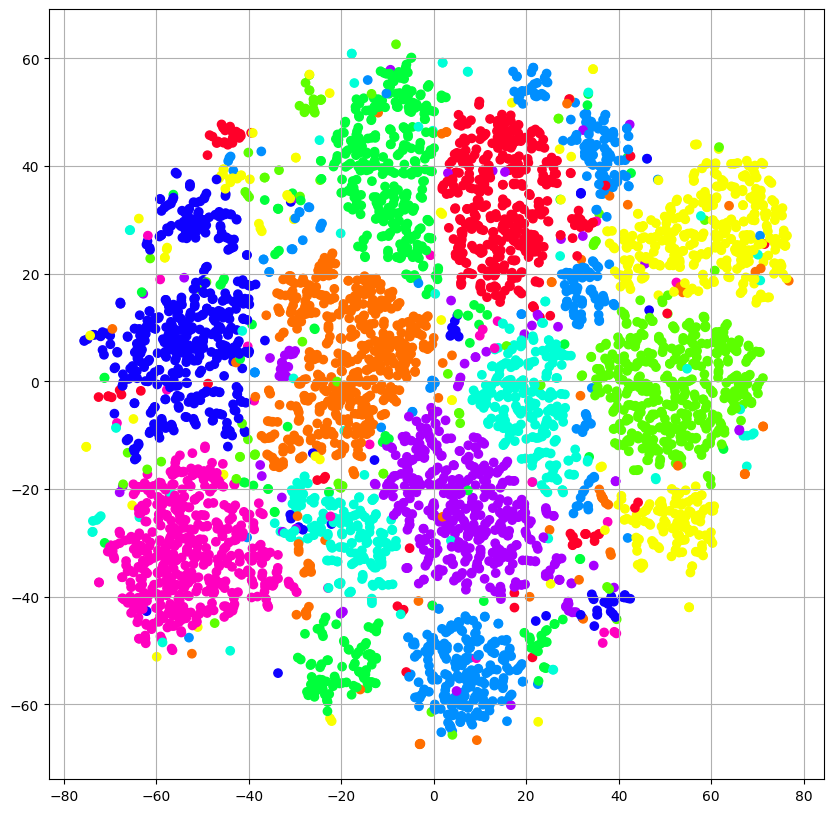

In [37]:
z_low = torch.from_numpy(TSNE(n_components=2).fit_transform(Z_with_C))

plt.figure(figsize=(10, 10))
plt.grid('on')
plt.scatter(z_low[:, 0], z_low[:, 1], c=labels, cmap='gist_rainbow')
plt.show()

Что вы думаете насчет этой картинки? Отличается от картинки для VAE?

Без условий пространство представления кажется хаотичным, условия же вносят ясность и делают пространство разделимым.
CVAE перестаёт сам делить пространство, ведь ему теперь это не нужно, а руководствуется лишь свойствами изображений.

# BONUS 1: Denoising

## Внимание! За бонусы доп. баллы не ставятся, но вы можете сделать их для себя.

У автоэнкодеров, кроме сжатия и генерации изображений, есть другие практические применения. Про одно из них эта бонусная часть задания.

Автоэнкодеры могут быть использованы для избавления от шума на фотографиях (denoising). Для этого их нужно обучить специальным образом: input картинка будет зашумленной, а выдавать автоэнкодер должен будет картинку без шума. 
То есть, loss-функция AE останется той же (MSE между реальной картинкой и выданной), а на вход автоэнкодеру будет подаваться зашумленная картинка.

<a href="https://ibb.co/YbRJ1nZ"><img src="https://i.ibb.co/0QD164t/Screen-Shot-2020-06-04-at-4-49-50-PM.png" alt="Screen-Shot-2020-06-04-at-4-49-50-PM" border="0"></a>

Для этого нужно взять ваш любимый датасет (датасет лиц из первой части этого задания или любой другой) и сделать копию этого датасета с шумом. 

In [38]:
is_training = False

AntiNoiseAutoencoder = Autoencoder
AntiNoiseAutoencoder.__name__ = "AntiNoiseAutoencoder"

device = 'cuda:0'
model = AntiNoiseAutoencoder().to(device)
model_name = model.__class__.__name__
model = initialize_weights(model)
noise_factor = 1.0
optimizer = torch.optim.AdamW(model.parameters(), lr=3e-4)
loss_fn = nn.MSELoss(reduction='mean')
global_step = 0
global_history = {
    'train': defaultdict(list),
    'valid': defaultdict(list),
}

if is_training:
    for epoch in range(1, 250+1):

        # --------- TRAIN STAGE ------------
        stage = 'train'
        history = defaultdict(list)
        model.train(True)
        for image in dl_train:
            image = image.permute(0, 3, 1, 2).float().to(device)
            noise = torch.randn_like(image).to(device)
            image_noised = image + noise_factor * noise
            image_out, z = model(image_noised)
            loss = loss_fn(image_out, image)
            optimizer.zero_grad() # clear gradients for this training step
            loss.backward() # backpropagation, compute gradients
            optimizer.step() # apply gradients
            history["loss"].append(loss.cpu().detach().numpy())
            global_step += 1

        # fill the global history
        if epoch % 1 == 0:
            global_history[stage]['epoch'].append(epoch)
            global_history[stage]['loss_avg'].append(np.mean(history['loss']))

        # printing
        if epoch % 10 == 0:
            print(f"Epoch: {epoch:04d}, stage: {stage}, loss_avg: {global_history[stage]['loss_avg'][-1]:.6f}")

        # --------- VALIDATION STAGE ------------
        stage = 'valid'
        history = defaultdict(list)
        model.train(False)
        with torch.no_grad():
            for image in dl_valid:
                image = image.permute(0, 3, 1, 2).float().to(device)
                noise = torch.randn_like(image).to(device)
                image_noised = image + noise_factor * noise
                image_out, z = model(image_noised)
                loss = loss_fn(image_out, image)
                history["loss"].append(loss.cpu().detach().numpy())

        # fill the global history
        if epoch % 1 == 0:
            global_history[stage]['epoch'].append(epoch)
            global_history[stage]['loss_avg'].append(np.mean(history['loss']))

        # printing
        if epoch % 50 == 0:
            print(f"Epoch: {epoch:04d}, stage: {stage}, loss_avg: {global_history[stage]['loss_avg'][-1]:.6f}")

        if epoch % 1 == 0:
            torch.save(model, f"models/{model_name}.pt")
            with open(f'history/{model_name}.hst', 'wb') as f:
                pickle.dump(global_history, f)
else:
    model = autoencoder = torch.load(f"models/{model_name}.pt", map_location=device)
    with open(f'history/{model_name}.hst', 'rb') as f:
            global_history = pickle.load(f)

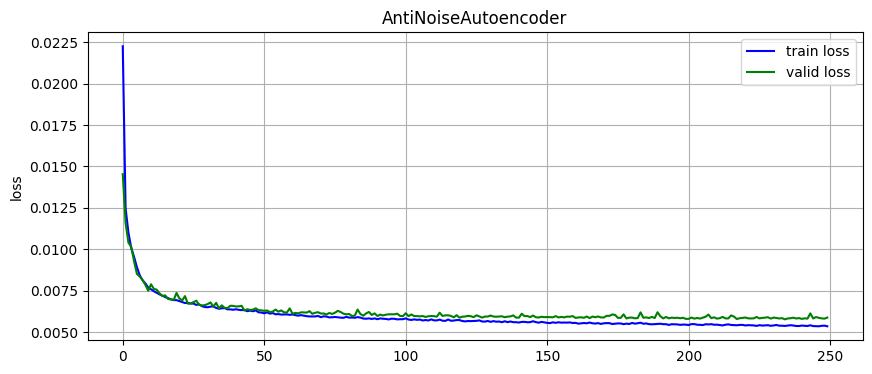

In [39]:
plot_training(global_history, model_name)

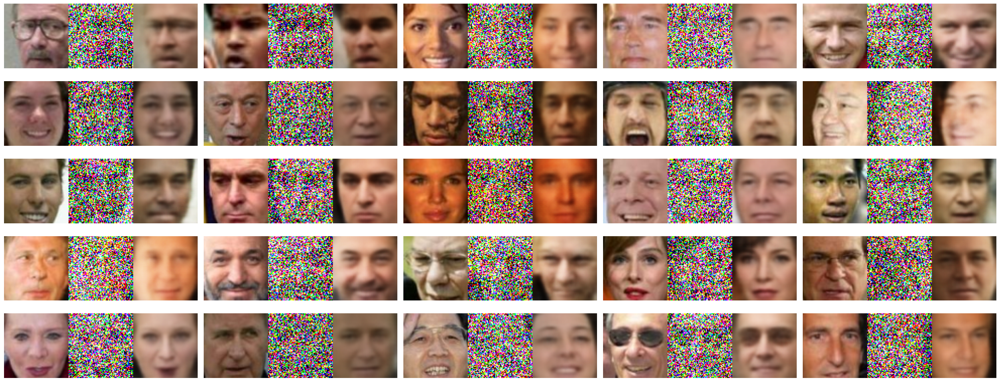

In [40]:
noise_factor = 1.0
images_true = []
images_noised = []
images_pred = []
with torch.no_grad():
    for step, image in enumerate(dl_valid):
        image = image.permute(0, 3, 1, 2).float().to(device)
        image_noised = image + noise_factor * torch.randn_like(image).to(device)
        image_out, z = model(image_noised)
        image_true = image[0,...].permute(1,2,0).cpu().detach().numpy()
        image_noised = image_noised[0,...].permute(1,2,0).cpu().detach().numpy()
        image_pred = image_out[0,...].permute(1,2,0).cpu().detach().numpy()
        images_true.append(image_true)
        images_noised.append(image_noised)
        images_pred.append(image_pred)
        if step==25:
            break

fig, axes = plt.subplots(5, 5, figsize=(25, 10))
for i, ax in enumerate(axes.ravel()):
    img_paired = np.concatenate([images_true[i], images_noised[i], images_pred[i]], 1)
    ax.imshow(np.clip(img_paired, 0, 1))
    ax.axis('off')
plt.tight_layout()
plt.show()

# BONUS 2: Image Retrieval

## Внимание! За бонусы доп. баллы не ставятся, но вы можете сделать их для себя.

Давайте представим, что весь наш тренировочный датасет -- это большая база данных людей. И вот мы получили картинку лица какого-то человека с уличной камеры наблюдения (у нас это картинка из тестового датасета) и хотим понять, что это за человек. Что нам делать? Правильно -- берем наш VAE, кодируем картинку в латентное представление и ищем среди латентных представлений лиц нашей базы самые ближайшие!

План:

1. Получаем латентные представления всех лиц тренировочного датасета
2. Обучаем на них LSHForest `(sklearn.neighbors.LSHForest)`, например, с `n_estimators=50`
3. Берем картинку из тестового датасета, с помощью VAE получаем ее латентный вектор
4. Ищем с помощью обученного LSHForest ближайшие из латентных представлений тренировочной базы
5. Находим лица тренировочного датасета, которым соответствуют ближайшие латентные представления, визуализируем!

Нет обученного VAE на лицах, то возьмем просто Autoencoder

In [41]:
model = torch.load(f"models/Autoencoder.pt", map_location=device)
codes = []
model.train(False)
with torch.no_grad():
    for image in ds_train:
        image = torch.Tensor(image).unsqueeze(0)
        image = image.permute(0, 3, 1, 2).float().to(device)
        z = model.encoder(image)
        codes.append(z.cpu().detach().numpy())

codes = np.concatenate(codes, axis=0)
print(codes.shape)

(11171, 64)


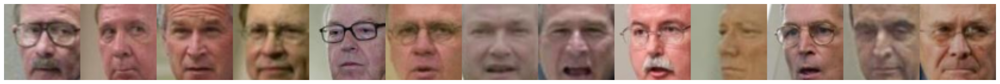

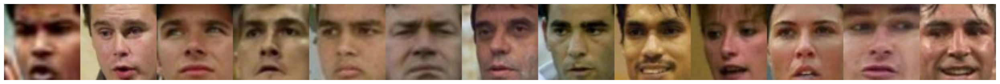

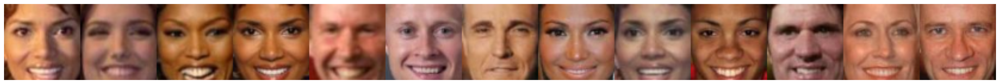

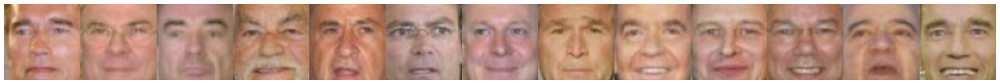

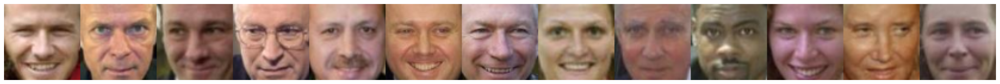

...

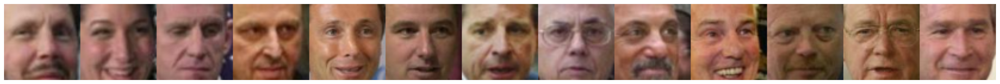

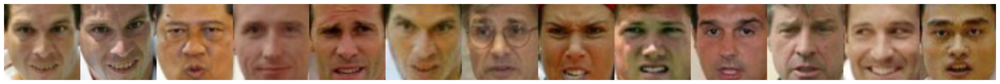

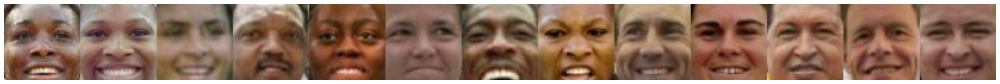

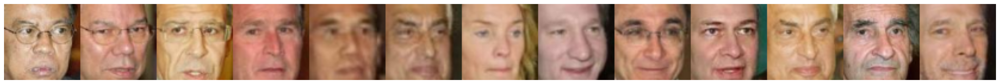

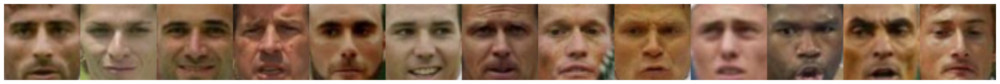

In [42]:
import sklearn

images = defaultdict(list)
model.train(False)
with torch.no_grad():
  for i, image in enumerate(ds_valid):
    images[i].append(image)
    tensor_image = torch.Tensor(image).unsqueeze(0)
    tensor_image = tensor_image.permute(0, 3, 1, 2).float().to(device)
    z = model.encoder(tensor_image)
    code = z.cpu().detach().numpy()
    distances = sklearn.metrics.pairwise_distances(codes, code, metric='euclidean', n_jobs=-1)
    sorted_distances_indices = np.argsort(distances[:, 0])
    for index in sorted_distances_indices[:12]:
      images[i].append(ds_train[index])
    if i==30:
      break

for persons in images.values():
  fig, ax = plt.subplots(1, 1, figsize=(25, 3))
  ax.imshow(np.concatenate(persons, 1))
  ax.axis('off')
  plt.tight_layout()
  plt.show()
